# Emma Grimm, Final Project
## Material of Language, Spring 2020
experiments with position, shape and density of asemic writing

In [2]:
import random
import math
from flat import document, shape, rgba
from IPython.display import SVG, display
def show(page):
    display(SVG(page.svg()))
from bezmerizing import Polyline
import numpy as np
from numpy.random import uniform, normal, choice
from IPython.display import Image as showimg

In [3]:
from scipy.stats import truncnorm
def t_normal(a, b, mu, sigma):
    tn = truncnorm((a-mu)/sigma, (b-mu)/sigma, loc=mu, scale=sigma)
    return tn.rvs(1)[0]

below: basic make_char function used to generate asemic writing. see output under code for glyph shape. you can check the notebook for assignment 3 to find more information on how this method was produced.

In [4]:
def make_char(startY, endY):
    height = math.floor(t_normal(1,7,4,3))
    width = math.floor(t_normal(2,5,4,2))
    
    pts = []
    pts.append([0,startY])
    pts.append([0,startY])
    pts.append([(1 - width*0.2),startY + normal(0,0.05)])

    for i in range(height):
        x = (1 - width*0.2) + normal(0,0.1)
        y = 0.25 * i + normal(0,0.05)
        pts.append([x,y])
    for i in range(width):
        x = (1 - width*0.2) + 0.2*i
        y = 0.2 * height + normal(0,0.1)
        pts.append([x,y])
    for i in range(height):
        x = 1 + normal(0,0.1)
        y = 0.25 * (height-i) + normal(0,0.05)
        pts.append([x,y])
    pts.append([1,endY])
    pts.append([1.2,endY])
    pts.append([1.2,endY])
    return Polyline(pts)

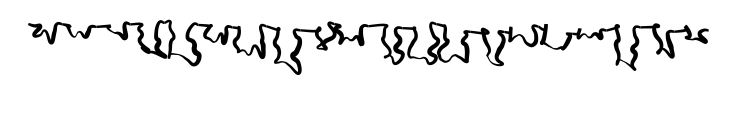

In [80]:
d = document(200, 30, 'mm')
page = d.addpage()
figure = shape().nostroke().fill(rgba(0, 0, 0, 255))

startY = t_normal(-0.2,0.2,0,0.3)
endY = 0

for i in range(20):
    endY = t_normal(-0.2,0.2,0,0.3)
    
    line = make_char(startY, endY).translate(i*1.2, 0)
    line = line.scale(10).translate(10, 10)
    poly = line.fancy_curve(samples_per=12, thicknesses=[0.8, t_normal(1.2,1.7,1.5,0.2), t_normal(0.3,0.7,0.5,0.2), t_normal(1.5,2,1.8,0.3), 0.8], tightness=-0.5)
    poly = figure.polygon(poly)
    page.place(poly)
    
    startY = endY

show(page)

below: repeating for loops while modifying line length and offset slightly to go from a more rigid to a more flowing structure.

In [131]:
d = document(260, 260, 'mm')
page = d.addpage()
figure = shape().nostroke().fill(rgba(0, 0, 0, 255))

startY = t_normal(-0.2,0.2,0,0.3)
endY = 0

for j in range(20):
    for i in range(20):
        endY = t_normal(-0.2,0.2,0,0.3)

        line = make_char(startY, endY).translate(i*1.2, j*1.2)
        line = line.scale(5).translate(10, 10)
        poly = line.fancy_curve(samples_per=12, thicknesses=[0.2, t_normal(1.2,1.7,1.5,0.2), t_normal(0.3,0.7,0.5,0.2), t_normal(1.5,2,1.8,0.3), 0.8], tightness=-0.5)
        poly = figure.polygon(poly)
        page.place(poly)

        startY = endY

startY = t_normal(-0.2,0.2,0,0.3)
endY = 0

for j in range(20):
    linelength = random.randint(14,18)
    offset = random.randint(0,20-linelength)
    for i in range(linelength):
        endY = t_normal(-0.2,0.2,0,0.3)

        line = make_char(startY, endY).translate(i*1.2 + offset, j*1.2)
        line = line.scale(5).translate(140, 10)
        poly = line.fancy_curve(samples_per=12, thicknesses=[0.8, t_normal(1.2,1.7,1.5,0.2), t_normal(0.3,0.7,0.5,0.2), t_normal(1.5,2,1.8,0.3), 0.8], tightness=-0.5)
        poly = figure.polygon(poly)
        page.place(poly)

        startY = endY
        
startY = t_normal(-0.2,0.2,0,0.3)
endY = 0

for j in range(20):
    linelength = random.randint(0,18)
    offset = random.randint(0,20-linelength)
    for i in range(linelength):
        endY = t_normal(-0.2,0.2,0,0.3)

        line = make_char(startY, endY).translate(i*1.2 + offset, j*1.2)
        line = line.scale(5).translate(10, 140)
        poly = line.fancy_curve(samples_per=12, thicknesses=[0.8, t_normal(1.2,1.7,1.5,0.2), t_normal(0.3,0.7,0.5,0.2), t_normal(1.5,2,1.8,0.3), 0.8], tightness=-0.5)
        poly = figure.polygon(poly)
        page.place(poly)

        startY = endY
        
for j in range(20):
    linelength = random.randint(0,6)
    offset = random.randint(0,20-linelength)
    for i in range(linelength):
        endY = t_normal(-0.2,0.2,0,0.3)

        line = make_char(startY, endY).translate(i*1.2 + offset, j*1.2)
        line = line.scale(5).translate(140, 140)
        poly = line.fancy_curve(samples_per=12, thicknesses=[0.8, t_normal(1.2,1.7,1.5,0.2), t_normal(0.3,0.7,0.5,0.2), t_normal(1.5,2,1.8,0.3), 0.8], tightness=-0.5)
        poly = figure.polygon(poly)
        page.place(poly)

        startY = endY


show(page)

below: repeating and slightly modifying for loops to create a more rigid structure that suggest familiar forms (eg. newspaper article).

In [312]:
d = document(260, 260, 'mm')
page = d.addpage()
figure = shape().nostroke().fill(rgba(0, 0, 0, 255))

startY = t_normal(-0.2,0.2,0,0.3)
endY = 0

for i in range(20):
    endY = t_normal(-0.2,0.2,0,0.3)
    
    line = make_char(startY, endY).translate(i*1.2, 0)
    line = line.scale(10).translate(10, 10)
    poly = line.fancy_curve(samples_per=12, thicknesses=[0.8, t_normal(1.2,1.7,1.5,0.2), t_normal(0.3,0.7,0.5,0.2), t_normal(1.5,2,1.8,0.3), 0.8], tightness=-0.5)
    poly = figure.polygon(poly)
    page.place(poly)
    
    startY = endY
    
startY = t_normal(-0.2,0.2,0,0.3)
endY = 0

for j in range(10):
    for i in range(20):
        endY = t_normal(-0.2,0.2,0,0.3)

        line = make_char(startY, endY).translate(i*1.2, j*1.2+4)
        line = line.scale(5).translate(10, 10)
        poly = line.fancy_curve(samples_per=12, thicknesses=[0.2, t_normal(1.2,1.7,1.5,0.2), t_normal(0.3,0.7,0.5,0.2), t_normal(1.5,2,1.8,0.3), 0.8], tightness=-0.5)
        poly = figure.polygon(poly)
        page.place(poly)

        startY = endY

startY = t_normal(-0.2,0.2,0,0.3)
endY = 0
        
for j in range(10):
    for i in range(20):
        endY = t_normal(-0.2,0.2,0,0.3)

        line = make_char(startY, endY).translate(i*1.2 + 25, j*1.2+4)
        line = line.scale(5).translate(10, 10)
        poly = line.fancy_curve(samples_per=12, thicknesses=[0.2, t_normal(1.2,1.7,1.5,0.2), t_normal(0.3,0.7,0.5,0.2), t_normal(1.5,2,1.8,0.3), 0.8], tightness=-0.5)
        poly = figure.polygon(poly)
        page.place(poly)

        startY = endY
        
startY = t_normal(-0.2,0.2,0,0.3)
endY = 0

for j in range(10):
    for i in range(41):
        endY = t_normal(-0.2,0.2,0,0.3)

        line = make_char(startY, endY).translate(i*1.2, j*1.2)
        line = line.scale(5).translate(10, 95)
        poly = line.fancy_curve(samples_per=12, thicknesses=[0.2, t_normal(1.2,1.7,1.5,0.2), t_normal(0.3,0.7,0.5,0.2), t_normal(1.5,2,1.8,0.3), 0.8], tightness=-0.5)
        poly = figure.polygon(poly)
        page.place(poly)

        startY = endY

show(page)

below: adding exponential growth to scaling and translation to suggest depth / glyphs gathering at a point in the distance. you can change the values on the final traslation of the line to get a more ordered progression as seen in the blog post.

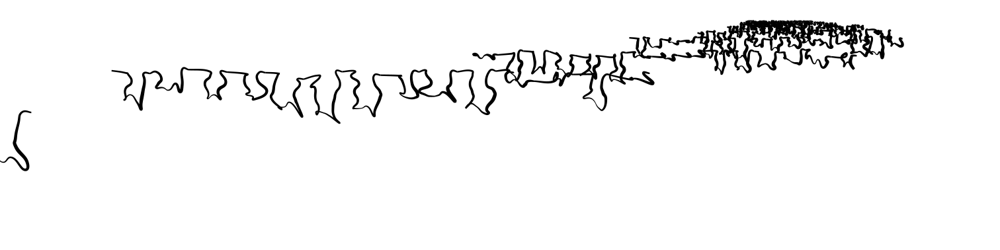

In [18]:
d = document(400, 100, 'mm')
page = d.addpage()
figure = shape().nostroke().fill(rgba(0, 0, 0, 255))
        
for j in range(10):
    startY = t_normal(-0.2,0.2,0,0.3)
    endY = 0
    for i in range(20-j):
        endY = t_normal(-0.2,0.2,0,0.3)

        line = make_char(startY, endY).translate(i*1.2, math.pow(1.1,j))
        line = line.scale(math.pow(1.5,j+1)).translate(400 - math.pow(2.3,j+1), 10)
        poly = line.fancy_curve(samples_per=12, thicknesses=[0.8, t_normal(1.2,1.7,1.5,0.2), t_normal(0.3,0.7,0.5,0.2), t_normal(1.5,2,1.8,0.3), 0.8], tightness=-0.5)
        poly = figure.polygon(poly)
        page.place(poly)

        startY = endY

show(page)

below: creating a premade alphabet of 25 glyphs to choose from for later compositions (greatly decreases time taken to execute code because of less nested loops). i also like the idea of meaningless letterforms that suggest meaning through repetition and recognizability.

In [6]:
startY = t_normal(-0.2,0.2,0,0.3)
endY = 0

letters = []
for i in range(25):
    endY = t_normal(-0.2,0.2,0,0.3)
    letters.append(make_char(startY, endY))
    startY = endY

below: saving one polyline to multiple arrays with x offset increasing by word and by array to create a glitchy effect. 

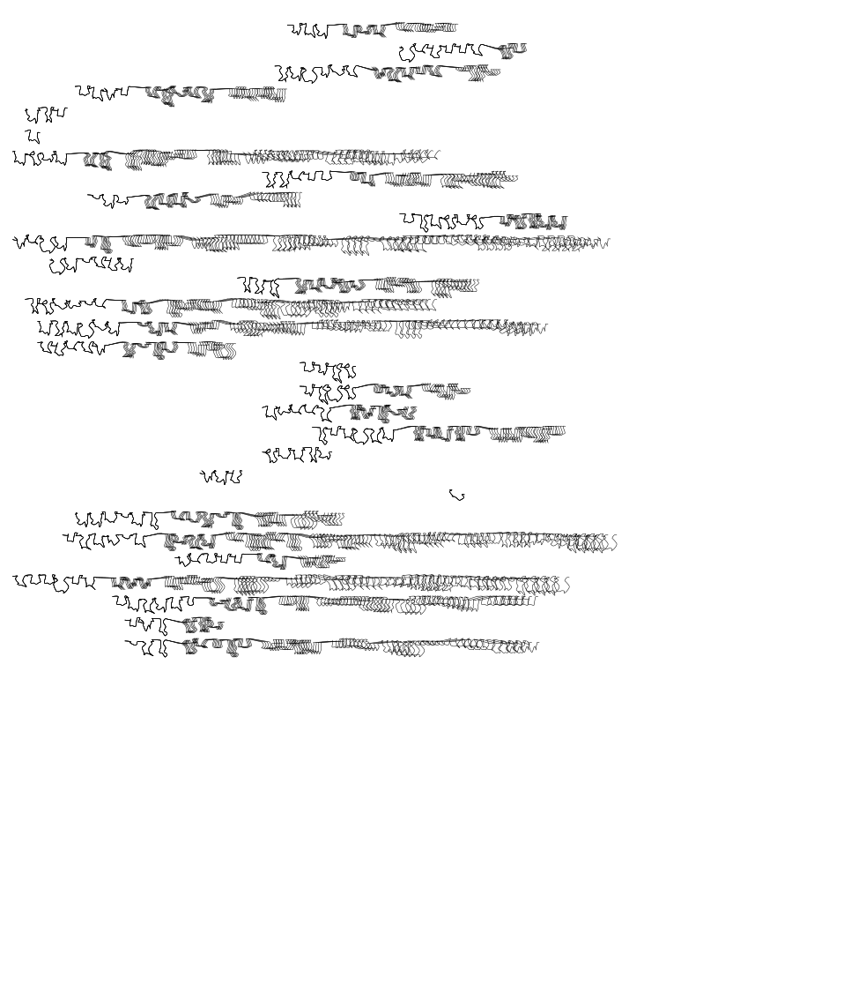

In [262]:
d = document(260, 300, 'mm')
page = d.addpage()

lines = [0,0,0,0]

for l in range(30):

    linewords = random.randint(0,10)

    offset = random.randint(0, (10-linewords) * 4)

    points = random.choice(letters).translate(offset,l*1.7)
    
    for n in range(len(lines)):
        lines[n] = points

    for w in range(linewords):

        wordlength = 0

        for i in range(1,random.randint(3,6)):
            points = random.choice(letters)
            
            for n in range(len(lines)):
                lines[n] += points.translate(offset + i*1.1 + (n * (w)) * 0.1, l*1.7)
            
            wordlength += 1.1

        offset += wordlength + 1

    for n in range(len(lines)):
        
        line = lines[n].scale(5).translate(0,10)
        curve_fig = shape().stroke(rgba(0, 0, 0, 255)).width(0.5)
        page.place(curve_fig.path(line.smooth_path()))
        
show(page) 


below: using sin wave with pi to create a waveform for x offset per word. the glyphs in the second array will move away from, then return, to those in the first array.

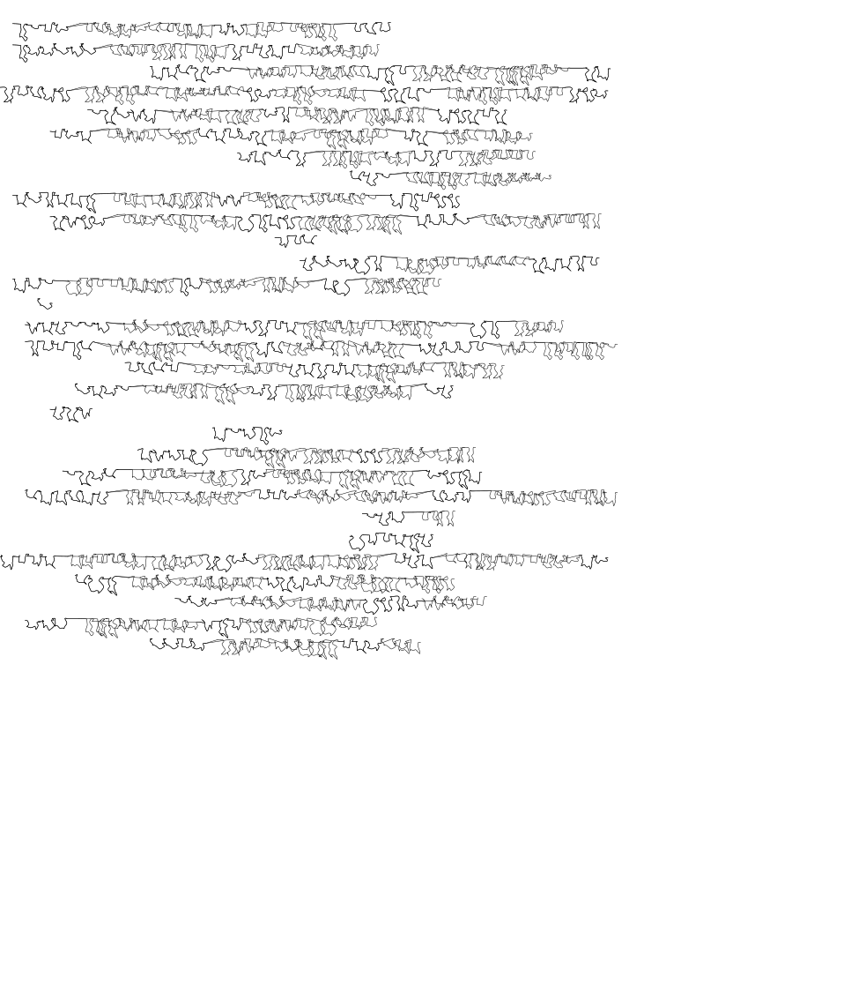

In [263]:
d = document(260, 300, 'mm')
page = d.addpage()

lines = [0,0]

for l in range(30):

    linewords = random.randint(0,10)

    offset = random.randint(0, (10-linewords) * 4)

    points = random.choice(letters).translate(offset,l*1.7)
    
    for n in range(len(lines)):
        lines[n] = points

    for w in range(linewords):

        wordlength = 0

        for i in range(1,random.randint(3,6)):
            points = random.choice(letters)
            
            for n in range(len(lines)):
                lines[n] += points.translate(offset + i*1.1 + math.sin(w*math.pi/3) * n, l*1.7)
            
            wordlength += 1.1

        offset += wordlength + 1

    for n in range(len(lines)):
        
        line = lines[n].scale(5).translate(0,10)
        curve_fig = shape().stroke(rgba(0, 0, 0, 255)).width(0.5)
        page.place(curve_fig.path(line.smooth_path()))
        
show(page)

below: adding normal to y values per word so that glyphs connect in a more interesting way.

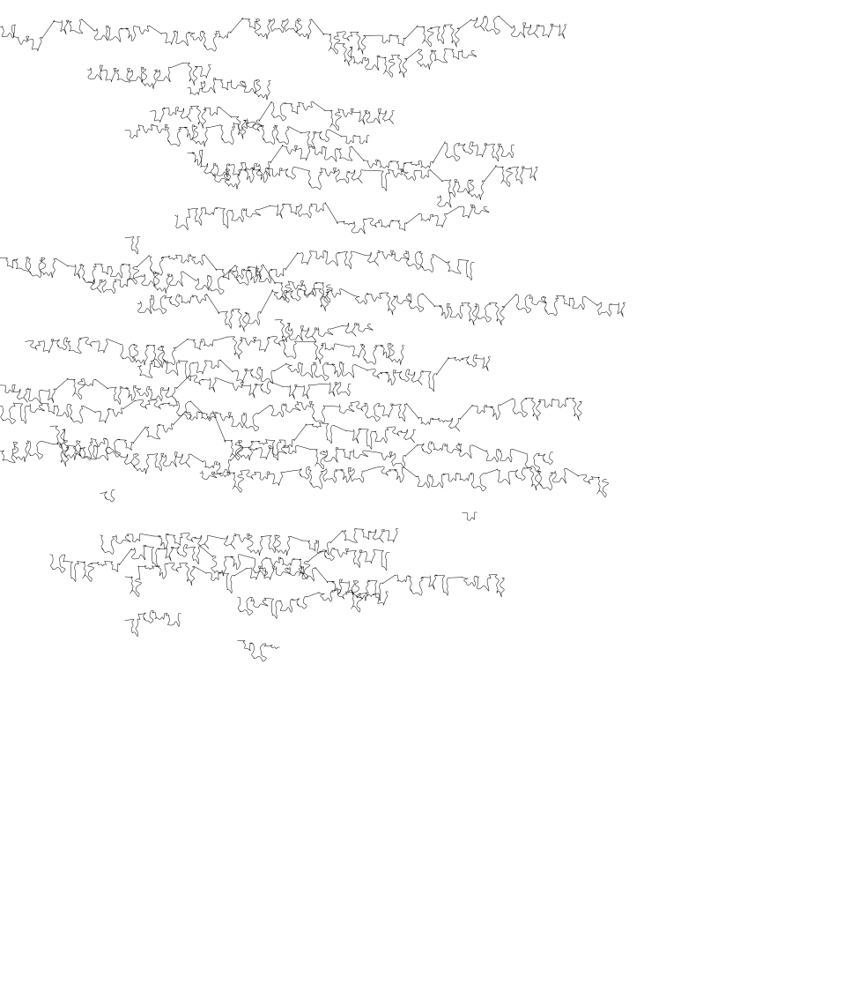

In [16]:
d = document(260, 300, 'mm')
page = d.addpage()

for l in range(30):
    
    linewords = random.randint(0,10)
    
    offset = random.randint(0, (10-linewords) * 4)
    
    line = random.choice(letters).translate(offset,l*1.7)
    
    for w in range(linewords):
        
        wordlength = 0
        weirdOffset = normal(0,0.5)
        
        for i in range(1,random.randint(3,6)):
            line += random.choice(letters).translate(offset + i*1.1,l*1.7 + weirdOffset)
            wordlength += 1.1
        
        offset += wordlength + 1
            
        
    line = line.scale(5).translate(0,10)
    curve_fig = shape().stroke(rgba(0, 0, 0, 255)).width(0.5)
    page.place(curve_fig.path(line.smooth_path()))
        
show(page) 


below: repeating code to draw a block of writing with meandering connections. changing y value at glyph level, not word level.

In [265]:
d = document(260, 300, 'mm')
page = d.addpage()

for n in range (2):
    for l in range(30):

        linewords = 10

        offset = 0

        line = random.choice(letters).translate(offset,l*1.7 + normal(0, 0.5))

        for w in range(linewords):

            wordlength = 0

            for i in range(1,random.randint(3,6)):
                line += random.choice(letters).translate(offset + i*1.1,l*1.7 + normal(0,0.5))
                wordlength += 1.1

            offset += wordlength + 1


        line = line.scale(5).translate(0,10)
        curve_fig = shape().stroke(rgba(0, 0, 0, 100)).width(1)
        page.place(curve_fig.path(line.smooth_path()))
        
show(page) 


below: added variation to line length and offset, and changed alpha values to simulate the way words fade and are written over. 

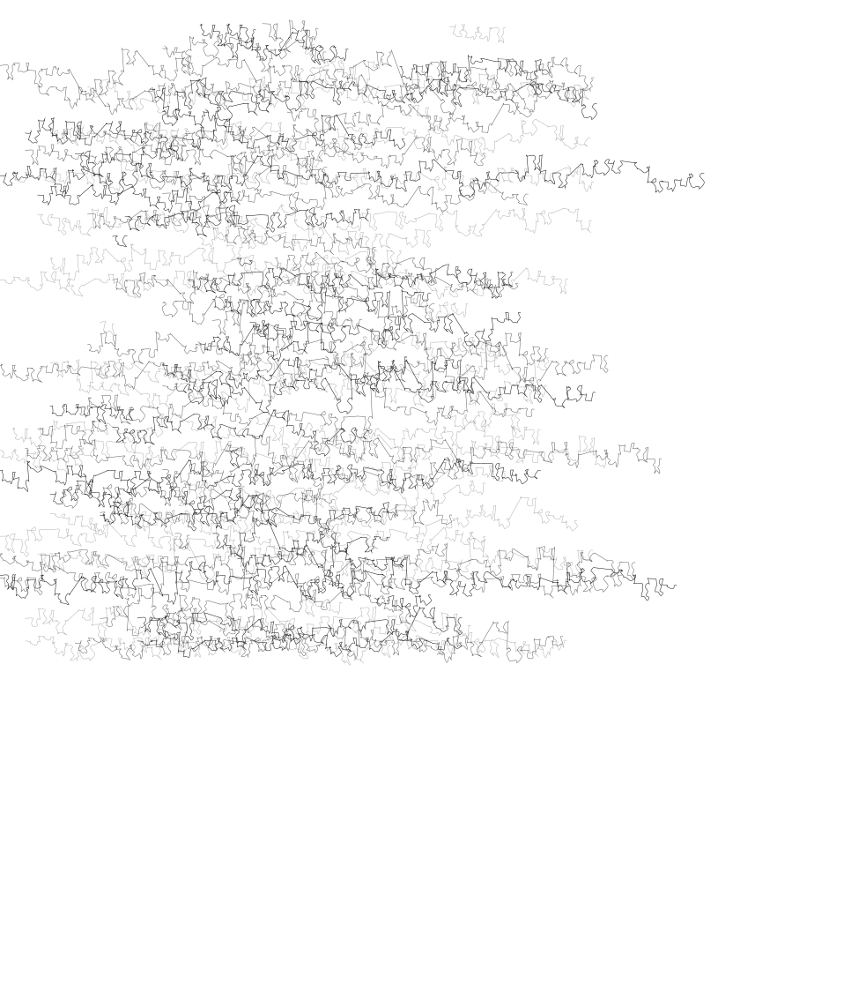

In [266]:
d = document(260, 300, 'mm')
page = d.addpage()

for n in range(3):
    for l in range(30):

        linewords = random.randint(0,10)

        offset = random.randint(0, (10-linewords) * 4)

        line = random.choice(letters).translate(offset,l*1.7)

        for w in range(linewords):

            wordlength = 0

            for i in range(1,random.randint(3,6)):
                line += random.choice(letters).translate(offset + i*1.1,l*1.7 + normal(0,0.5))
                wordlength += 1.1

            offset += wordlength + 1


        line = line.scale(5).translate(0,10)
        curve_fig = shape().stroke(rgba(0, 0, 0, (n+1) * 80)).width(0.5)
        page.place(curve_fig.path(line.smooth_path()))
        
show(page) 


below: defined a "transition" function that adds a polyline from the end of the last "word" to the start of the next, with a specified number of points, so that the connecting lines are less rigid. added current and next x and y variables to allow words to move all over the page.  you can change ranges for a, b and c to create different densities.

In [8]:
def transition(currentX, currentY, nextX, nextY, length):
    
    pts = []
    intervalX = (nextX - currentX) / length
    intervalY = (nextY - currentY) / length
    
    x = currentX
    y = currentY
    
    for i in range(length):
        x += intervalX + normal(0,0.1)
        y += intervalY + normal(0,0.1)
        pts.append([x,y])
    
    return Polyline(pts)

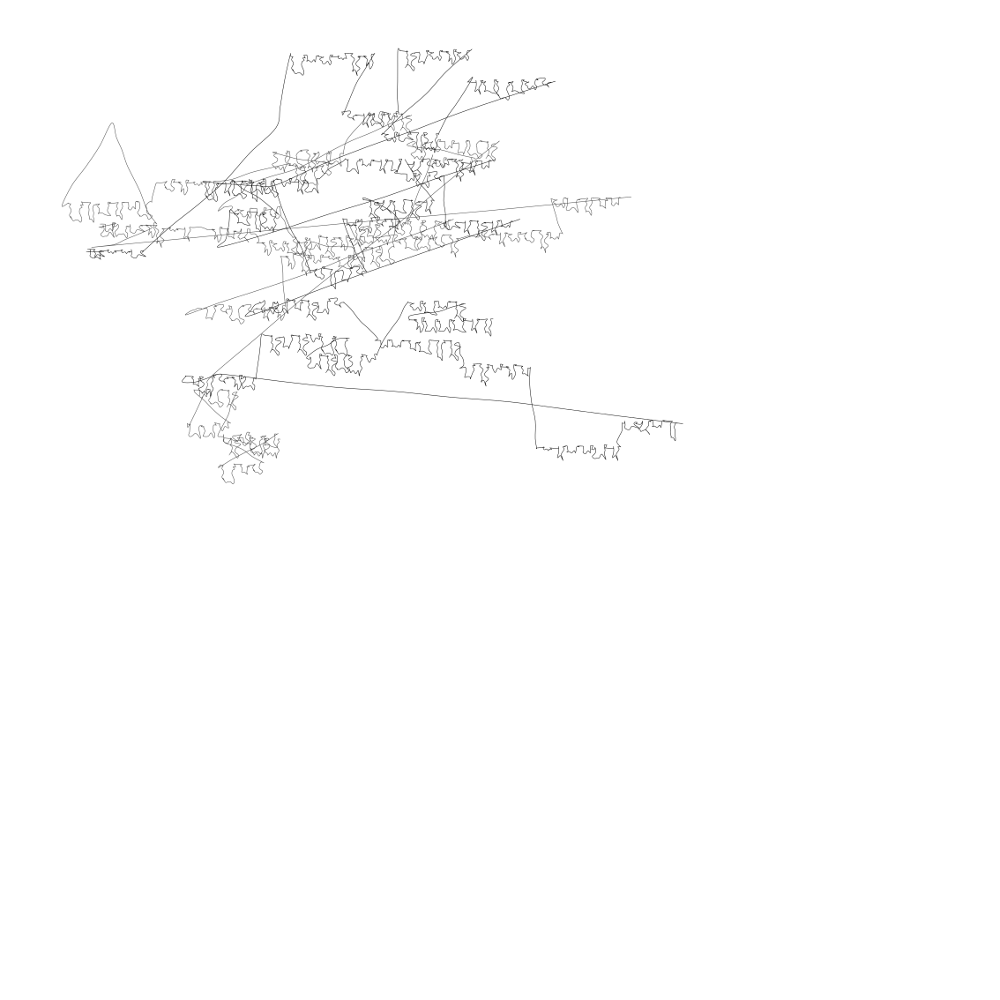

In [14]:
d = document(300, 300, 'mm')
page = d.addpage()

for a in range(2):

    offset = 0

    nextX = random.randint(5,10)
    nextY = random.randint(5,10)

    line = random.choice(letters).translate(nextX,nextY)
    
    for i in range(random.randint(3,6)):
            line += random.choice(letters).translate(nextX + offset,nextY)
            offset += 1.1

    currentX = nextX + offset
    currentY = nextY
    
    for b in range(5):

        nextX = random.randint(5,20)
        nextY = 5 * b

        line += transition(currentX, currentY, nextX, nextY, random.randint(3,8))

        currentX = nextX
        currentY = nextY

        for c in range(5):

            offset = 0

            nextX = currentX + normal(0,3)
            nextY = currentY + normal(0,3)

            line += transition(currentX, currentY, nextX, nextY, 4)

            for i in range(random.randint(3,6)):
                line += random.choice(letters).translate(nextX + offset,nextY)
                offset += 1.1

            currentX = nextX + offset
            currentY = nextY

    line = line.scale(5).translate(10,50)
    curve_fig = shape().stroke(rgba(0, 0, 0, random.randint(150,250))).width(0.5)
    page.place(curve_fig.path(line.smooth_path()))

        
show(page) 

below: drew some glyph sequences disconnected from the main sequence over the top to try and get a more interesting shape. got a more boring shape.

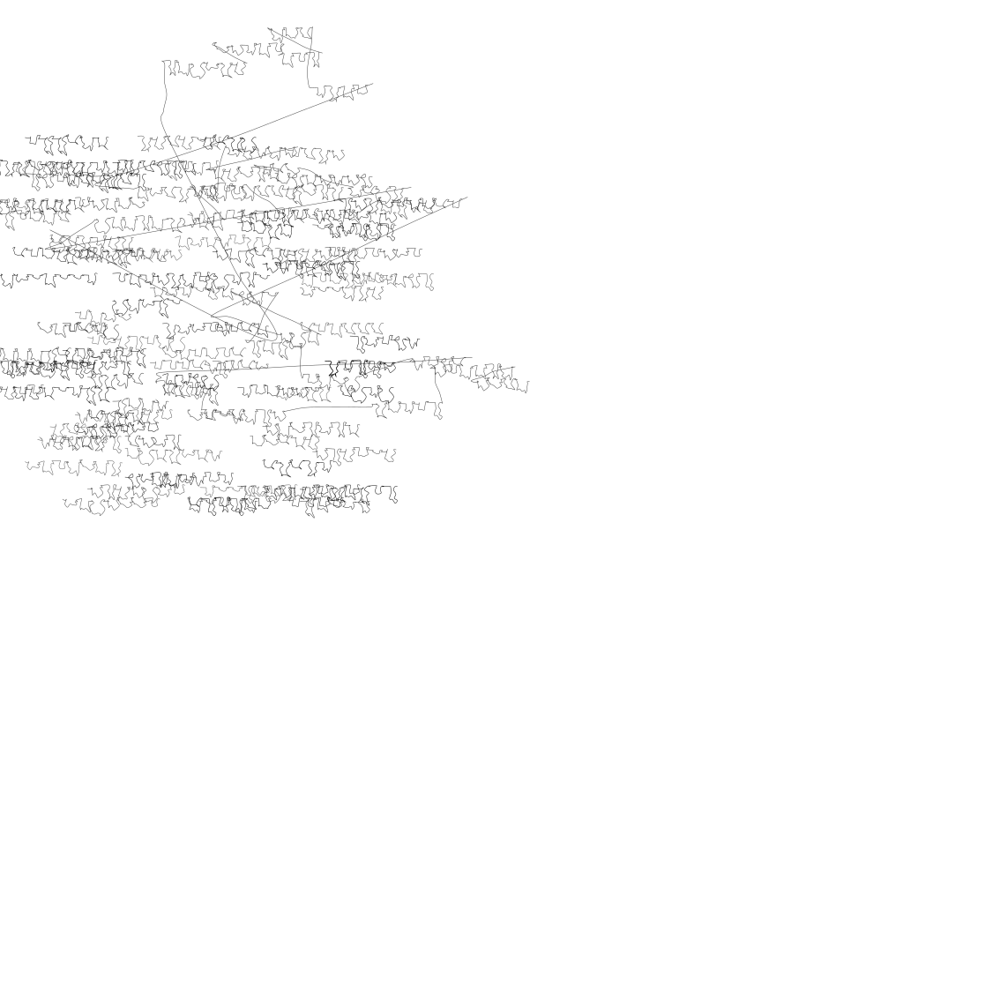

In [290]:
d = document(300, 300, 'mm')
page = d.addpage()


line = random.choice(letters).translate(random.randint(5,10), random.randint(5,10))
    
for b in range(5):

    nextX = random.randint(5,20)
    nextY = 5 * b

    line += transition(currentX, currentY, nextX, nextY, 4)

    currentX = nextX
    currentY = nextY

    for c in range(5):

        offset = 0

        nextX = currentX + normal(0,3)
        nextY = currentY + normal(0,3)

        line += transition(currentX, currentY, nextX, nextY, 4)

        for i in range(random.randint(3,6)):
            line += random.choice(letters).translate(nextX + offset,nextY)
            offset += 1.1

        currentX = nextX + offset
        currentY = nextY

line = line.scale(5).translate(-10,50)
curve_fig = shape().stroke(rgba(0, 0, 0, random.randint(150,250))).width(0.5)
page.place(curve_fig.path(line.smooth_path()))

for i in range(100):
    posX = random.randint(1,30)
    posY = random.randint(1,30)
    
    offset = 1.1
    
    line = random.choice(letters).translate(posX, posY)
    
    for j in range(random.randint(3,6)):
        line += random.choice(letters).translate(posX + offset, posY)
        offset += 1.1
    
    line = line.scale(5).translate(-10,50)
    curve_fig = shape().stroke(rgba(0, 0, 0, random.randint(150,250))).width(0.5)
    page.place(curve_fig.path(line.smooth_path()))
       
show(page)

below: changed the transition function slightly to add some more weirdness to the connecting lines (by changing the parameters for normal). then created an array of "hubs" that lines will start over from after writing 20 "words" or connected sequences of glyphs. you can change the ranges for b and c to change densities. i like that these end up feeling almost like a topographic map.

In [390]:
def transition(currentX, currentY, nextX, nextY, length):
    
    pts = []
    intervalX = (nextX - currentX) / length
    intervalY = (nextY - currentY) / length
    
    x = currentX
    y = currentY
    
    for i in range(length):
        x += intervalX + normal(0,0.4)
        y += intervalY + normal(0,0.3)
        pts.append([x,y])
    
    return Polyline(pts)

In [360]:
hubs = [[5,40],[40,10], [30,60],[10,20]]

d = document(400, 300, 'mm')
page = d.addpage()

line = random.choice(letters).translate(random.randint(5,10), random.randint(5,10))

for b in range(20):
    
    hub = random.randint(0,len(hubs)-1)

    nextX = hubs[hub][0]
    nextY = hubs[hub][1]

    line = random.choice(letters).translate(nextX,nextY)

    currentX = nextX
    currentY = nextY

    for c in range(20):

        offset = 0

        nextX = currentX + normal(-5,3)
        nextY = currentY + normal(0,3)

        line += transition(currentX, currentY, nextX, nextY, 4)

        for i in range(random.randint(3,6)):
            line += random.choice(letters).translate(nextX + offset,nextY)
            offset += 1.1

        currentX = nextX + offset
        currentY = nextY

    line = line.scale(3).translate(100,50)
    curve_fig = shape().stroke(rgba(0, 0, 0, random.randint(150,250))).width(0.5)
    page.place(curve_fig.path(line.smooth_path()))

        
show(page) 

you can modify hub values, ranges for b and c, and normal values for changing nextX and nextY to get a different output. i like placing the hubs in a line to create a dense base from which glyphs seem to float up like smoke.

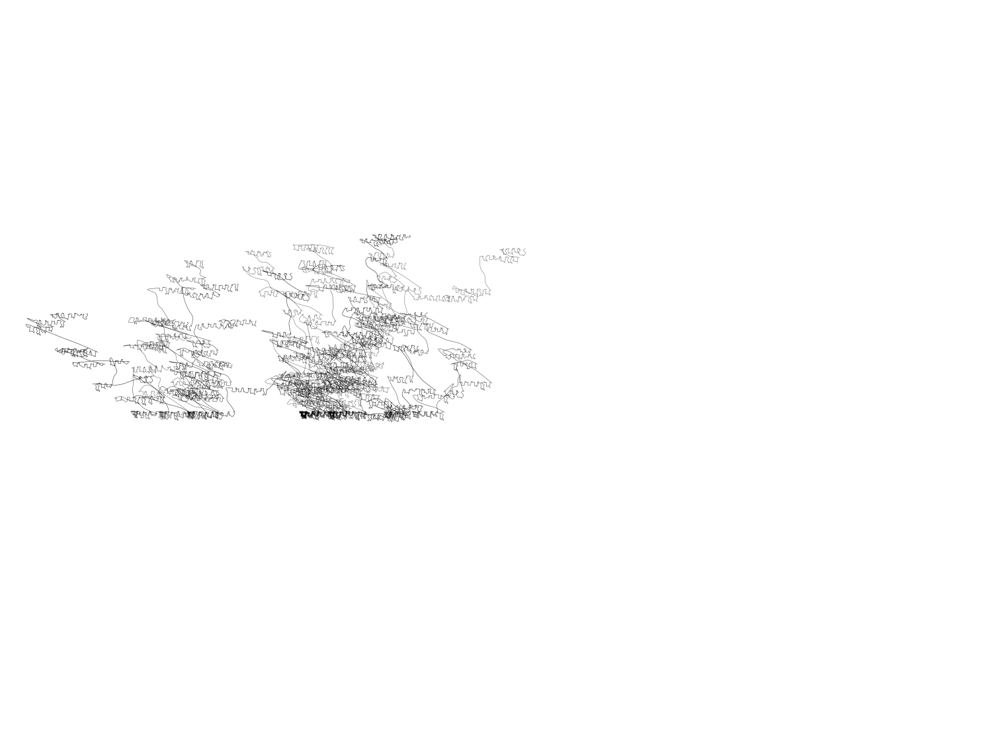

In [402]:
hubs = [[5,40],[10,40],[15,40],[20,40],[25,40],[40,40],[45,40],[55,40],[60,40],[65,40]]

d = document(400, 300, 'mm')
page = d.addpage()

line = random.choice(letters).translate(random.randint(5,10), random.randint(5,10))

for b in range(30):
    
    hub = int(t_normal(0,len(hubs)-1,5,3))
    
    offset = 0

    nextX = hubs[hub][0]
    nextY = hubs[hub][1]

    line = random.choice(letters).translate(nextX,nextY)
    
    for i in range(random.randint(3,6)):
            line += random.choice(letters).translate(nextX + offset,nextY)
            offset += 1.1

    currentX = nextX + offset
    currentY = nextY

    for c in range(random.randint(2,10)):

        offset = 0
        
        if c < 10:
            nextX = currentX + normal(-4,3)
            nextY = currentY + normal(-3,2)
        
        else:
            nextX = currentX + normal(-4,5)
            nextY = currentY + normal(-1,3)

        line += transition(currentX, currentY, nextX, nextY, 4)

        for i in range(random.randint(3,6)):
            line += random.choice(letters).translate(nextX + offset,nextY)
            offset += 1.1

        currentX = nextX + offset
        currentY = nextY

    line = line.scale(3).translate(40,100)
    curve_fig = shape().stroke(rgba(0, 0, 0, random.randint(150,250))).width(0.5)
    page.place(curve_fig.path(line.smooth_path()))

        
show(page) 